# CT5166 Assignment 2

Please submit this assignment as an iPython Notebook (.ipynb) file to Canvas. Please provide comments throughout the code to document and explain your decisions.

This assignment concerns the development of a link prediction system based on WikiData. The link prediction task predicts links that are missing from this dataset.

## Task 1 [15 marks]

Choose a subset of the data in Wikidata by choosing a suitable query and extracting relevant triples from the graph using the SPARQL query endpoint at https://query.wikidata.org/

For example, you may select all triples whose subject is of type [Human](http://www.wikidata.org/entity/Q5) as follows:

```sparql
SELECT ?s ?p ?o
WHERE
{
  ?s ?p ?o . # Select all triples
  ?s wdt:P31 wd:Q5 . # Of type human
  # Filter to only links within Wikidata
  FILTER(strstarts(str(?o), "http://www.wikidata.org/entity/Q"))
}
# Limit to 10,000 results
LIMIT 10000
```

Download the results as CSV or JSON. Your subset should have at least 10,000 triples.

**You must use a different query to the one above in your solution**



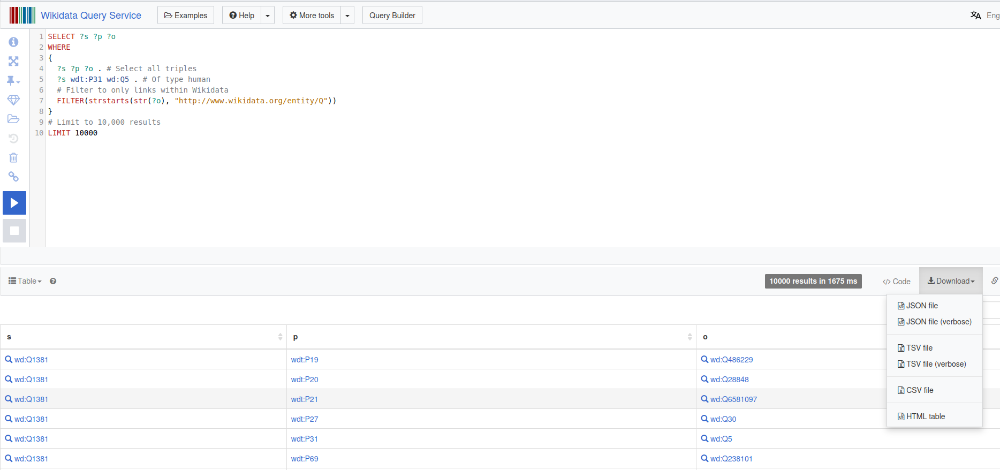

In [1]:
import pandas as pd

# Load the CSV file into a DataFrame
file_path = "books_data.csv"  # Path to the dataset
try:
    df = pd.read_csv(file_path)
except FileNotFoundError:
    print(f"Error: File not found at {file_path}")
    exit()

# Function to extract entity ID from URLs
# This isolates the last part of the URL, assuming it's the unique identifier
# Example: "http://example.com/entity/P31" --> "P31"
def extract_name(url):
    return url.split("/")[-1] if isinstance(url, str) else url  # Ensures no errors for NaN values

# Create a copy of the DataFrame to avoid modifying the original data
df_clean = df.copy()

# Apply the extraction function to relevant columns
# These columns are assumed to contain URLs from which entity IDs need to be extracted
df_clean["book"] = df_clean["book"].apply(extract_name)
df_clean["property"] = df_clean["property"].apply(extract_name)
df_clean["value"] = df_clean["value"].apply(extract_name)

# Display the unique properties in the dataset
unique_properties = df_clean["property"].unique()
print("Unique Properties in Dataset:")
print(unique_properties)

# Count and display occurrences of each property
property_counts = df_clean["property"].value_counts()
print("\nProperty Counts:")
print(property_counts)

# Check for missing values in each column
missing_values = df_clean.isnull().sum()
print("\nMissing Values:")
print(missing_values)

# Save the cleaned dataset to a new CSV file
clean_file_path = "clean_books.csv"
df_clean.to_csv(clean_file_path, index=False)
print(f"\nCleaned data saved as {clean_file_path}")

# Display the first few rows of the cleaned dataset to verify changes
print("\nPreview of Cleaned Data:")
print(df_clean.head())


Unique Properties in Dataset:
['P31' 'P50' 'P136' 'P407' 'P921' 'P123' 'P195' 'P276' 'P361' 'P6216'
 'P7937' 'P2860' 'P941' 'P17' 'P291' 'P98' 'P495' 'P840' 'P110' 'P736'
 'P747' 'P910' 'P179' 'P437' 'P86' 'P170' 'P138' 'P825' 'P1424' 'P1889'
 'P144' 'P2679' 'P1343' 'P1433' 'P1552' 'P1558' 'P710' 'P793' 'P1071'
 'P1891' 'P2058' 'P1269' 'P629' 'P155' 'P156' 'P186' 'P166' 'P767' 'P655'
 'P2739' 'P2389' 'P5008' 'P2079' 'P180' 'P1435' 'P2348' 'P275' 'P1434'
 'P126' 'P7137' 'P527' 'P4969' 'P674' 'P6104' 'P6954' 'P4032' 'P5059'
 'P1411' 'P859' 'P750' 'P872' 'P175' 'P4101' 'P287' 'P8646' 'P2360'
 'P4510' 'P972' 'P1574' 'P2680' 'P172' 'P88' 'P7228' 'P1299' 'P1344'
 'P184' 'P641']

Property Counts:
property
P31      2316
P50      1478
P921     1478
P407      820
P123      639
         ... 
P172        1
P7228       1
P1299       1
P184        1
P641        1
Name: count, Length: 87, dtype: int64

Missing Values:
book        0
property    0
value       0
dtype: int64

Cleaned data saved as clean

# Task 2 [15 marks]

Select a property that you plan to predict and divide your data into a train/validation/test split, based on the links that you wish to predict. To simulate missing links, you should remove some triples from the validation/test and use these to evaluate the predictions.

In [20]:
import pandas as pd
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

In [21]:
# ==================== DATA CLEANING AND FORMATTING ====================

# Load the cleaned dataset
file_path = "clean_books.csv"
df_cleaned = pd.read_csv(file_path)

# Define the predicate for converting to triple format
predicate = "P31"  # P31 commonly denotes "instance of"

# Convert dataset to (subject, predicate, object) format for PyKEEN compatibility
df_triples = df_cleaned[["book", "value"]].copy()
df_triples.insert(1, "property", predicate)  # Insert the predicate as the second column

# Save formatted dataset for PyKEEN
pykeen_file_path = "book_formatted.csv"
df_triples.to_csv(pykeen_file_path, index=False, header=False, sep="\t")
print("Formatted dataset saved as 'book_formatted.csv'")

# Show the first few rows to verify
print("Formatted Data:")
print(df_triples.head())

Formatted dataset saved as 'book_formatted.csv'
Formatted Data:
        book property      value
0  Q81647955      P31       Q571
1  Q81647955      P31    Q110971
2  Q81647955      P31  Q30277550
3  Q81647955      P31       Q188
4  Q81647955      P31     Q57253


In [26]:
# Display unique properties in the dataset
unique_properties = df_cleaned["property"].unique()
print("Unique Properties in Dataset:")
print(unique_properties)

# Count occurrences of each property
property_counts = df_cleaned["property"].value_counts()
print("\nProperty Counts:")
print(property_counts)

Unique Properties in Dataset:
['P31' 'P50' 'P136' 'P407' 'P921' 'P123' 'P195' 'P276' 'P361' 'P6216'
 'P7937' 'P2860' 'P941' 'P17' 'P291' 'P98' 'P495' 'P840' 'P110' 'P736'
 'P747' 'P910' 'P179' 'P437' 'P86' 'P170' 'P138' 'P825' 'P1424' 'P1889'
 'P144' 'P2679' 'P1343' 'P1433' 'P1552' 'P1558' 'P710' 'P793' 'P1071'
 'P1891' 'P2058' 'P1269' 'P629' 'P155' 'P156' 'P186' 'P166' 'P767' 'P655'
 'P2739' 'P2389' 'P5008' 'P2079' 'P180' 'P1435' 'P2348' 'P275' 'P1434'
 'P126' 'P7137' 'P527' 'P4969' 'P674' 'P6104' 'P6954' 'P4032' 'P5059'
 'P1411' 'P859' 'P750' 'P872' 'P175' 'P4101' 'P287' 'P8646' 'P2360'
 'P4510' 'P972' 'P1574' 'P2680' 'P172' 'P88' 'P7228' 'P1299' 'P1344'
 'P184' 'P641']

Property Counts:
property
P31      2316
P50      1478
P921     1478
P407      820
P123      639
         ... 
P172        1
P7228       1
P1299       1
P184        1
P641        1
Name: count, Length: 87, dtype: int64


In [22]:
# ==================== DATA SPLITTING ====================

# Load the formatted dataset for splitting
file_path = "book_formatted.csv"
df_triples = pd.read_csv(file_path, sep="\t", header=None, names=["book", "property", "value"])

# Split dataset into Train (80%), Validation (10%), and Test (10%)
train_data, temp_data = train_test_split(df_triples, test_size=0.3, random_state=42)
val_data, test_data = train_test_split(temp_data, test_size=0.5, random_state=42)

# Save the split datasets
train_data.to_csv("train_triples_new.csv", index=False, header=False, sep="\t")
val_data.to_csv("val_triples_new.csv", index=False, header=False, sep="\t")
test_data.to_csv("test_triples_new.csv", index=False, header=False, sep="\t")
print("Data successfully split and saved.")
# Print confirmation
print(f"Dataset split completed:\nTrain: {len(train_data)}\nValidation: {len(val_data)}\nTest: {len(test_data)}")

Data successfully split and saved.
Dataset split completed:
Train: 7000
Validation: 1500
Test: 1500


In [23]:
# ==================== TRIPLE REMOVAL FOR LINK PREDICTION ====================

# Load split datasets
train_data = pd.read_csv("train_triples_new.csv", sep="\t", header=None, names=["book", "property", "value"])
val_data = pd.read_csv("val_triples_new.csv", sep="\t", header=None, names=["book", "property", "value"])
test_data = pd.read_csv("test_triples_new.csv", sep="\t", header=None, names=["book", "property", "value"])

# Identify unique "book" entities (subjects)
unique_books = train_data["book"].unique()

# Select 10% of entities for triple removal to simulate missing information
num_remove = int(0.1 * len(unique_books))
books_to_remove = np.random.choice(unique_books, num_remove, replace=False)

# Remove triples involving these entities in the validation and test sets
val_filtered = val_data[~val_data["book"].isin(books_to_remove)]
test_filtered = test_data[~test_data["book"].isin(books_to_remove)]

# Save the modified datasets
val_filtered.to_csv("filtered_val_triples_new.csv", index=False, header=False, sep="\t")
test_filtered.to_csv("filtered_test_triples_new.csv", index=False, header=False, sep="\t")

# Print confirmation of removal
num_removed_val = len(val_data) - len(val_filtered)
num_removed_test = len(test_data) - len(test_filtered)
print(f"Removed triples to create knowledge gaps for link prediction.")
print(f"Removed {num_removed_val} triples from validation set.")
print(f"Removed {num_removed_test} triples from test set.")
print("Filtered datasets saved as 'filtered_val_triples_new.csv' and 'filtered_test_triples_new.csv'.")



Removed triples to create knowledge gaps for link prediction.
Removed 128 triples from validation set.
Removed 157 triples from test set.
Filtered datasets saved as 'filtered_val_triples_new.csv' and 'filtered_test_triples_new.csv'.


Formatted dataset saved as 'book_formatted.csv'
Formatted Data:
        book property      value
0  Q81647955      P31       Q571
1  Q81647955      P31    Q110971
2  Q81647955      P31  Q30277550
3  Q81647955      P31       Q188
4  Q81647955      P31     Q57253
Data successfully split and saved.
Dataset split completed:
Train: 7000
Validation: 1500
Test: 1500
Removed triples to create knowledge gaps for link prediction.
Removed 152 triples from validation set.
Removed 136 triples from test set.
Filtered datasets saved as 'filtered_val_triples_new.csv' and 'filtered_test_triples_new.csv'.


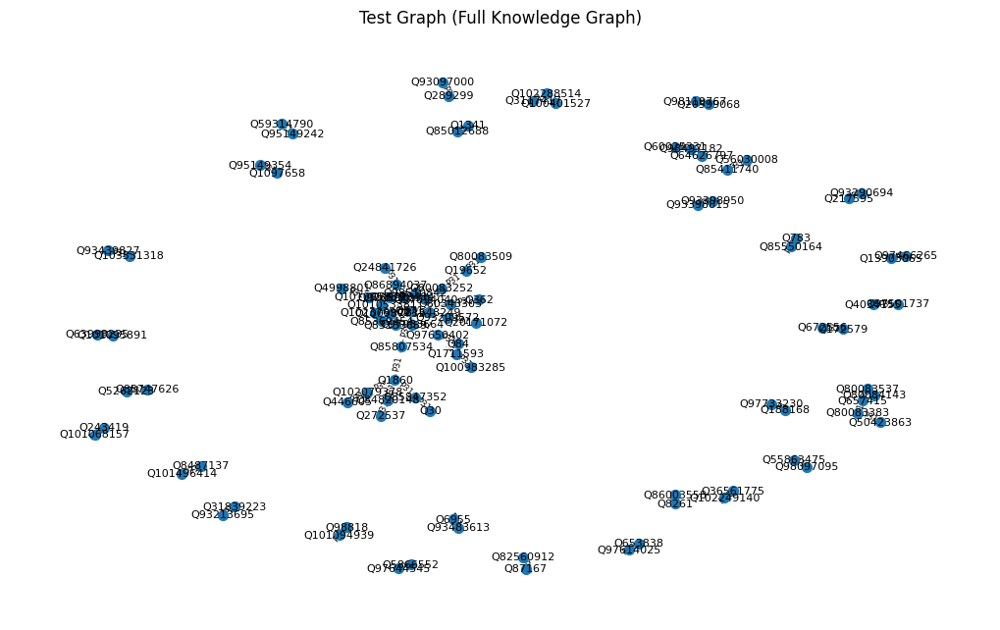

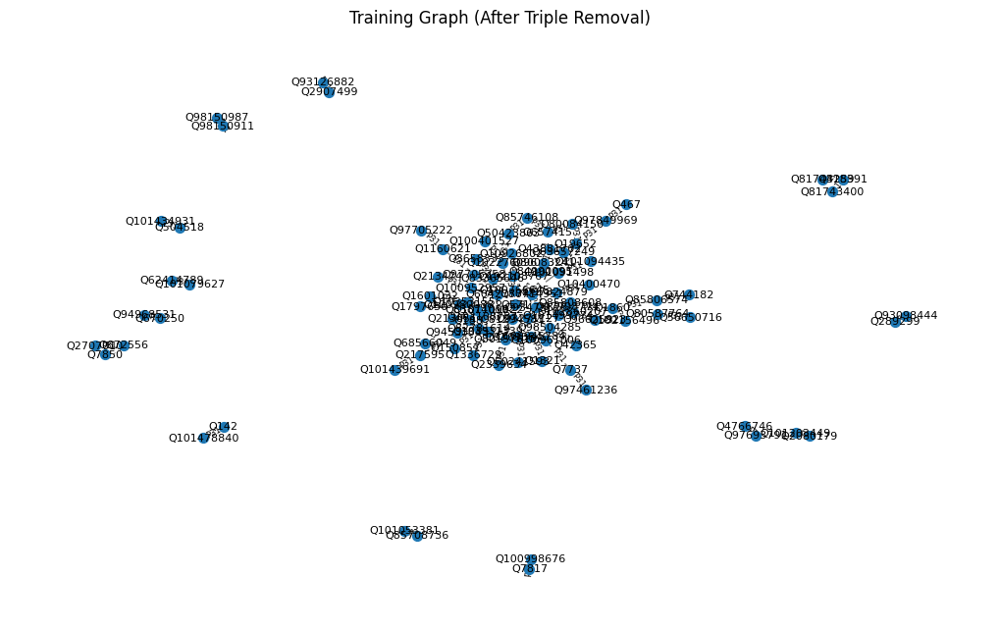

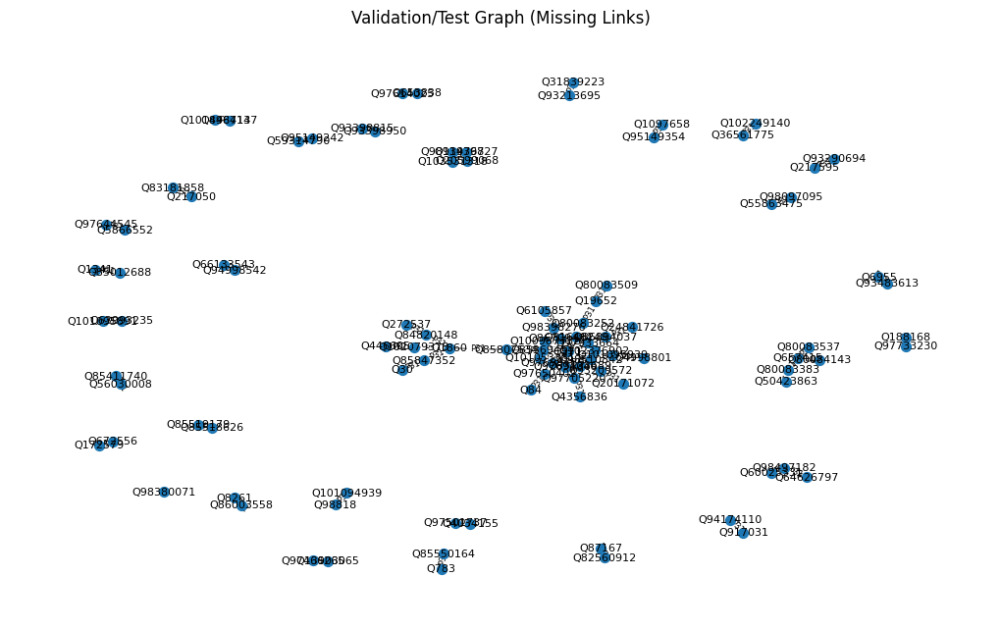

In [3]:
# ==================== VISUALIZATION ====================

# Function to create and visualize knowledge graphs
def visualize_graph(df, title, node_limit=100):
    G = nx.Graph()

    # Add edges (subject -> object) with properties as labels
    for _, row in df.iterrows():
        G.add_edge(row["book"], row["value"], label=row["property"])

    # Limit nodes for visualization clarity
    if len(G.nodes) > node_limit:
        subgraph_nodes = list(G.nodes)[:node_limit]
        G = G.subgraph(subgraph_nodes)

    # Visualize the graph
    plt.figure(figsize=(10, 6))
    pos = nx.spring_layout(G, seed=42)  # Graph layout for clear visualization
    nx.draw(G, pos, with_labels=True, node_size=50, font_size=8, edge_color="gray")
    nx.draw_networkx_edge_labels(G, pos, edge_labels={(u, v): d["label"] for u, v, d in G.edges(data=True)}, font_size=6)
    plt.title(title)
    plt.show()

# Load datasets for visualization
test_data = pd.read_csv("test_triples_new.csv", sep="\t", header=None, names=["book", "property", "value"])
train_data = pd.read_csv("train_triples_new.csv", sep="\t", header=None, names=["book", "property", "value"])
removed_data = pd.read_csv("filtered_test_triples_new.csv", sep="\t", header=None, names=["book", "property", "value"])

# Visualizing knowledge graphs
visualize_graph(test_data, "Test Graph (Full Knowledge Graph)")
visualize_graph(train_data, "Training Graph (After Triple Removal)")
visualize_graph(removed_data, "Validation/Test Graph (Missing Links)")


# Task 3 [40 marks]

Use the [PyKEEN library](https://pykeen.readthedocs.io/en/stable/), to create entity embeddings for the graph. Use a similarity metric to predict similarity and use this to predict the links. You should evaluate at least two algorithms for graph embeddings.

In [6]:
# Install PyKEEN

!pip install pykeen

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.5/85.5 kB 2.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 718.4/718.4 kB 13.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 383.6/383.6 kB 27.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 47.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 29.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 33.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 13.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [4]:
import pandas as pd
import torch
import numpy as np
from pykeen.triples import TriplesFactory
from pykeen.pipeline import pipeline
from pykeen.models import TransE, ComplEx



# Load training, validation, and test sets into PyKEEN format
train_fact = TriplesFactory.from_path("train_triples_new.csv")
val_fact = TriplesFactory.from_path("filtered_val_triples_new.csv")
test_fact = TriplesFactory.from_path("filtered_test_triples_new.csv")

# Function to train and evaluate models in PyKEEN
def train_and_evaluate_model(model_name):
    print(f"Training model: {model_name}")

    # Train the model using PyKEEN's pipeline
    result = pipeline(
        training=train_fact,
        validation=val_fact,
        testing=test_fact,
        model=model_name,
        training_kwargs=dict(num_epochs=500, batch_size=256),
        random_seed=42,
        device="cpu"
    )




    # Extract entity embeddings
    entity_embeddings = result.model.entity_representations[0]._embeddings.weight.detach().cpu().numpy()

    return result, entity_embeddings

# Train two different models (TransE and ComplEx)
transE_result, transE_embeddings = train_and_evaluate_model("TransE")
complex_result, complex_embeddings = train_and_evaluate_model("ComplEx")

# Save embeddings for later use
np.save("transE_embeddings.npy", transE_embeddings)
np.save("complex_embeddings.npy", complex_embeddings)

# Print confirmation
print("Embeddings generated and saved as 'transE_embeddings_new.npy' and 'complex_embeddings_new.npy'.")



INFO:pykeen.pipeline.api:Using device: cpu


Training model: TransE


Training epochs on cpu:   0%|          | 0/500 [00:00<?, ?epoch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Evaluating on cpu:   0%|          | 0.00/1.36k [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 5.50s seconds
INFO:pykeen.pipeline.api:Using device: cpu


Training model: ComplEx


Training epochs on cpu:   0%|          | 0/500 [00:00<?, ?epoch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Training batches on cpu:   0%|          | 0/27 [00:00<?, ?batch/s]

Evaluating on cpu:   0%|          | 0.00/1.36k [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 12.02s seconds


Embeddings generated and saved as 'transE_embeddings_new.npy' and 'complex_embeddings_new.npy'.


In [5]:
import numpy as np
import pandas as pd
from sklearn.metrics.pairwise import cosine_similarity

# Load embeddings
transE_embeddings = np.load("transE_embeddings_new.npy")
complex_embeddings = np.load("complex_embeddings_new.npy")

# Load entity mappings
train_data_new = pd.read_csv("train_triples_new.csv", sep="\t", header=None, names=["book", "property", "value"])
test_data_new = pd.read_csv("test_triples_new.csv", sep="\t", header=None, names=["book", "property", "value"])

# Get unique entity list
entities = np.unique(np.concatenate((train_data_new["book"], train_data_new["value"])))
entity_to_index = {entity: i for i, entity in enumerate(entities)}

# Filter books in test set
missing_book = [p for p in test_data_new["book"].unique() if p in entity_to_index]
book_predi = [u for u in train_data_new["book"].unique() if u in entity_to_index]

# Function to predict links
def predict_links(embeddings, similarity_metric="cosine"):
    predictions = {}

    for book in missing_book:
        if book not in entity_to_index:
            continue

        book_idx = entity_to_index[book]
        book_embedding = embeddings[book_idx].reshape(1, -1)

        # Compute similarity
        book_indices = [entity_to_index[u] for u in book_predi if u != book]  # Exclude itself
        book_embeddings = embeddings[book_indices]

        # Compute similarity scores in a batch
        if similarity_metric == "cosine":
            similarities = cosine_similarity(book_embedding, book_embeddings).flatten()
        else:  # Euclidean Distance
            similarities = -np.linalg.norm(book_embedding - book_embeddings, axis=1)

        # Get top 200 predictions
        top_indices = np.argsort(similarities)[::-1][:500]
        predictions[book] = [(book_predi[i], float(similarities[i])) for i in top_indices]  # Convert np.float32 to float

    return predictions

# Get predictions using both models
transE_predictions = predict_links(transE_embeddings, "cosine")
complex_predictions = predict_links(complex_embeddings, "cosine")

# Print sample predictions
print("Sample Predictions (TransE):", list(transE_predictions.items())[:500])
print("Sample Predictions (ComplEx):", list(complex_predictions.items())[:500])


Sample Predictions (TransE): [('Q97466265', [('Q80084148', 0.4966379702091217), ('Q97876577', 0.4791538417339325), ('Q95502353', 0.47798195481300354), ('Q101497897', 0.47252053022384644), ('Q97579666', 0.472362220287323), ('Q97705204', 0.446772962808609), ('Q86010221', 0.4441929757595062), ('Q101011904', 0.436666876077652), ('Q85876729', 0.4330315589904785), ('Q92677402', 0.4266890287399292), ('Q94994621', 0.4258163571357727), ('Q102319698', 0.42180007696151733), ('Q85111337', 0.4158274829387665), ('Q86837321', 0.41032859683036804), ('Q85109628', 0.40690821409225464), ('Q84758016', 0.4058842360973358), ('Q84851128', 0.40347471833229065), ('Q83205173', 0.3978978991508484), ('Q83164730', 0.3957269787788391), ('Q80083373', 0.39219170808792114), ('Q85284058', 0.3895304203033447), ('Q86907029', 0.3870007395744324), ('Q80083248', 0.38588279485702515), ('Q84458982', 0.38422176241874695), ('Q102108837', 0.38208869099617004), ('Q101052345', 0.38062453269958496), ('Q80084088', 0.3763260543346405

In [6]:
import numpy as np
import pandas as pd

# Load ground truth data
ground_truth = pd.read_csv("filtered_test_triples_new.csv", sep="\t", header=None, names=["book", "property", "value"])

# Function to evaluate model predictions
def evaluate_predictions(predictions):
    hits_at_1 = 0
    hits_at_10 = 0
    total_rank = 0
    total_samples = 0

    for _, row in ground_truth.iterrows():
        book = row["book"]
        true_value = row["value"]

        if book not in predictions:
            continue

        predicted_list = [pred[0] for pred in predictions[book]]  # Extract predicted book IDs

        if true_value in predicted_list:
            rank = predicted_list.index(true_value) + 1  # Get ranking position (1-based)
            total_rank += rank
            hits_at_10 += 1  # If it's in the top 5
            if rank == 1:
                hits_at_1 += 1  # If it's ranked 1st
        total_samples += 1

    hits_at_1_score = hits_at_1 / total_samples
    hits_at_10_score = hits_at_10 / total_samples
    mean_rank_score = total_rank / total_samples

    return {
        "Hits@1": hits_at_1_score,
        "Hits@10": hits_at_10_score,
        "Mean Rank": mean_rank_score
    }

# Evaluate both models
transE_eval = evaluate_predictions(transE_predictions)
complex_eval = evaluate_predictions(complex_predictions)  # Using ComplEx instead of DistMult

# Print results
print("TransE Evaluation:", transE_eval)
print("ComplEx Evaluation:", complex_eval)

TransE Evaluation: {'Hits@1': 0.0015479876160990713, 'Hits@5': 0.009287925696594427, 'Mean Rank': 1.0665634674922602}
ComplEx Evaluation: {'Hits@1': 0.0, 'Hits@5': 0.005417956656346749, 'Mean Rank': 1.5952012383900929}


# Task 4 [30 marks]

Use the [PyTorch Geometric (PyG)](https://pyg.org/) library to create a graph neural network and use this to improve the prediction of the links. Compare the results with the graph embedding approach.

For further usage of the PyG model you could look at this tutorial:

https://medium.com/@pytorch_geometric/link-prediction-on-heterogeneous-graphs-with-pyg-6d5c29677c70

In [7]:
pip install torch-geometric torch-scatter torch-sparse torch-cluster torch-spline-conv


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.1/63.1 kB 1.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 108.0/108.0 kB 4.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 210.0/210.0 kB 9.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 3.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 28.2 MB/s eta 0:00:00
  Created wheel for torch-scatter: filename=torch_scatter-2.1.2-cp311-cp311-linux_x86_64.whl size=547369 sha256=19afd8c2c78e2c87855b04bdc198e5f685c180b0e85a36dc358395a04f1a8451
  Stored in directory: /root/.cache/pip/wheels/b8/d4/0e/a80af2465354ea7355a2c153b11af2da739cfcf08b6c0b28e2
  Created wheel for torch-sparse: filename=torch_sparse-0.6.18-cp311-cp311-linux_x86_64.whl size=1127935 sha256=42edefbc12ea7c19d19fa2ba13783ac031edcb6

In [10]:
import pandas as pd
import torch
from torch_geometric.data import Data

# Load the dataset
train_data_new = pd.read_csv("train_triples_new.csv", sep="\t", header=None, names=["book", "propoerty", "value"])
test_data_new = pd.read_csv("filtered_test_triples_new.csv", sep="\t", header=None, names=["book", "propoerty", "value"])

# Create a mapping of entities to numerical IDs
entities = pd.concat([train_data_new["book"], train_data_new["value"]]).unique()
entity_to_id = {entity: i for i, entity in enumerate(entities)}

# Convert triples into edge index format for PyG
edges = torch.tensor(
    [[entity_to_id[p], entity_to_id[u]] for p, u in zip(train_data_new["book"], train_data_new["value"])],
    dtype=torch.long
).T  # Transpose to match PyG format

# Create PyG data object
data = Data(edge_index=edges)
print(data)


Data(edge_index=[2, 7000])


In [12]:
import torch.nn as nn
import torch_geometric.nn as pyg_nn

class GCNLinkPredictor(nn.Module):
    def __init__(self, num_nodes, embedding_dim=64, feature_dim=16):
        super().__init__()
        self.embedding = nn.Embedding(num_nodes, embedding_dim)  # Learnable node embeddings
        self.feature_layer = nn.Linear(feature_dim, embedding_dim)  # Transform feature space
        self.conv1 = pyg_nn.GCNConv(embedding_dim, 128)
        self.conv2 = pyg_nn.GCNConv(128, 64)
        self.dropout = nn.Dropout(p=0.3)  # Dropout
        self.fc = nn.Linear(64, 1)

    def forward(self, edge_index):
        x = self.embedding.weight  # Base node embeddings
        x = self.conv1(x, edge_index).relu()
        x = self.dropout(x)
        x = self.conv2(x, edge_index).relu()
        x = self.dropout(x)
        return x


In [15]:
import random
import torch.optim as optim

model = GCNLinkPredictor(num_nodes=len(entity_to_id))

# Generate negative edges using numerical IDs
all_book_ids = [entity_to_id[p] for p in train_data_new["book"].unique() if p in entity_to_id]
all_value_ids = [entity_to_id[u] for u in train_data_new["value"].unique() if u in entity_to_id]

# Limit num_neg_samples to the smaller population size
num_neg_samples = min(len(data.edge_index[0]), len(all_book_ids), len(all_value_ids))

# Ensure valid sampling
if len(all_book_ids) >= num_neg_samples:
    sampled_book = random.sample(all_book_ids, num_neg_samples)
else:
    sampled_book = random.choices(all_book_ids, k=num_neg_samples)  # Allows repetition if needed

if len(all_value_ids) >= num_neg_samples:
    sampled_value = random.sample(all_value_ids, num_neg_samples)
else:
    sampled_value = random.choices(all_value_ids, k=num_neg_samples)  # Allows repetition if needed

# Create negative edges tensor
negative_edges = torch.tensor(
    list(zip(sampled_book, sampled_value)),
    dtype=torch.long
).T  # Transpose to match PyG format

# Define loss and optimizer with lower learning rate
criterion = nn.BCEWithLogitsLoss()
optimizer = optim.Adam(model.parameters(), lr=0.0005)  # Lower learning rate

# Training loop with dropout and negative sampling
for epoch in range(50):
    model.train()
    optimizer.zero_grad()

    # Forward pass
    node_embeddings = model(data.edge_index)  # Get embeddings

    # Positive edges
    edge_src = data.edge_index[0]
    edge_dst = data.edge_index[1]
    pos_preds = (node_embeddings[edge_src] * node_embeddings[edge_dst]).sum(dim=1)

    # Negative edges
    neg_src = negative_edges[0]
    neg_dst = negative_edges[1]
    neg_preds = (node_embeddings[neg_src] * node_embeddings[neg_dst]).sum(dim=1)

    # Create labels
    target_pos = torch.ones_like(pos_preds, dtype=torch.float)  # Label = 1 for real edges
    target_neg = torch.zeros_like(neg_preds, dtype=torch.float)  # Label = 0 for fake edges

    # Combine and compute loss
    preds = torch.cat([pos_preds, neg_preds])
    targets = torch.cat([target_pos, target_neg])
    loss = criterion(preds, targets)

    # Backward pass
    loss.backward()
    optimizer.step()

    if epoch % 10 == 0:
        print(f"Epoch {epoch}: Loss = {loss.item()}")


Epoch 0: Loss = 2.3023929595947266
Epoch 10: Loss = 1.0859835147857666
Epoch 20: Loss = 0.5950166583061218
Epoch 30: Loss = 0.47306787967681885
Epoch 40: Loss = 0.4844098389148712


# Predict Missing Links Using the GNN

In [16]:
# Predict new links
with torch.no_grad():
    model.eval()
    node_embeddings = model(data.edge_index)

    # Compute similarity scores
    similarity_matrix = torch.matmul(node_embeddings, node_embeddings.T)

# Show top predictions
print("Top link predictions from GNN:", similarity_matrix[:5, :5])


Top link predictions from GNN: tensor([[1.8693, 0.3730, 0.0752, 0.4266, 0.8502],
        [0.3730, 1.0473, 0.2530, 0.2365, 0.4403],
        [0.0752, 0.2530, 4.5711, 0.8327, 0.8477],
        [0.4266, 0.2365, 0.8327, 2.0951, 0.4732],
        [0.8502, 0.4403, 0.8477, 0.4732, 1.8948]])


# Evaluate GNN vs. PyKEEN (TransE, DistMult)

In [19]:
# Function to evaluate Hits@1, Hits@5, Mean Rank
def evaluate_gnn_predictions(predictions, ground_truth):
    hits_at_1 = 0
    hits_at_5 = 0
    total_rank = 0
    total_samples = len(ground_truth)

    for book, true_value in zip(ground_truth["book"], ground_truth["value"]):
        if book not in entity_to_id or true_value not in entity_to_id:
            continue  # Skip if entity is missing

        book_idx = entity_to_id[book]
        value_idx = entity_to_id[true_value]

        # Get similarity scores
        scores = similarity_matrix[book_idx]
        top_value = torch.argsort(scores, descending=True)[:5]  # Top 5 predictions

        rank = (top_value == value_idx).nonzero(as_tuple=True)[0]
        if len(rank) > 0:
            rank = rank.item() + 1
            total_rank += rank
            if rank == 1:
                hits_at_1 += 1
            if rank <= 5:
                hits_at_5 += 1

    return {
        "Hits@1": hits_at_1 / total_samples,
        "Hits@5": hits_at_5 / total_samples,
        "Mean Rank": total_rank / total_samples
    }

# Evaluate the GNN model
gnn_results = evaluate_gnn_predictions(node_embeddings, test_data_new)

# Print results
print("GNN Evaluation:", gnn_results)


GNN Evaluation: {'Hits@1': 0.156158357771261, 'Hits@5': 0.22360703812316715, 'Mean Rank': 0.35777126099706746}
